In [11]:
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
import librosa
import torch
import pandas as pd
import re
import IPython.display as ipd
import warnings

import Pytorch_Generator
import AudioDataset

plt.ylim(-1.0, 1.0)
warnings.filterwarnings("ignore", category=UserWarning) 

### Get the original noise and music files

In [12]:
%matplotlib notebook

with open("/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/metadata.txt") as noiseMetadataFile:
    noiseFiles = [line.strip() for line in noiseMetadataFile]

base_folder = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/"
metadata_path = base_folder + "Sounds/ProcessedTest/metadata.txt"
metadata_file = open(metadata_path)
metadata = metadata_file.read()

reg = re.compile("(/home.*.wav) \+ (/home.*.mp3)")
originalFiles = reg.findall(metadata)

In [13]:
def calculate_anc(base_folder, noisy_music_folder, ancFolder, offset=2, display=True):
    mses = []
    for i in range(20):
        
        noisy_music_file = base_folder + noisy_music_folder + str(i * 20 + offset) + ".RAW"
        noisy_music = sf.SoundFile(noisy_music_file, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
        noisy_music = librosa.util.normalize(noisy_music)
        
        noise_file = base_folder + ancFolder + str(i) + ".RAW"
        noise = sf.SoundFile(noise_file, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
        noise_offset = np.subtract(noise, np.mean(noise))
        noise_norm = librosa.util.normalize(noise_offset)
        noise_inv = np.negative(noise_norm)

        anc_music = np.add(noisy_music, noise_inv)
        
        og_music, _ = librosa.load(originalFiles[i * 20 + offset][1].strip(), mono=True, sr=44100, duration=1.30)
        og_noise, _ = librosa.load(originalFiles[i * 20 + offset][0].strip(), mono=True, sr=44100, duration=1.30)
        
        og_music = librosa.util.normalize(og_music)
        og_noise = librosa.util.normalize(og_noise)
        if display:
            fig, axes = plt.subplots(1, 2, sharey='all')

            axes[0].plot(og_music, label="Original music", alpha=1)
            axes[0].plot(anc_music, label="Music with cancelled noise", alpha = 0.5)

            axes[1].plot(og_noise, label="Original noise", alpha = 1)
            axes[1].plot(noise_inv, label="Inverse of extracted noise", alpha=0.5)

            fig.legend()
            fig.show()
            
            og_music_clip    = np.clip(og_music,    -1.0, 1.0)
            og_noise_clip    = np.clip(og_noise,    -1.0, 1.0)
            anc_music_clip   = np.clip(anc_music,   -1.0, 1.0)
            noisyMusicClip = np.clip(noisy_music, -1.0, 1.0)

            print("Original Music")
            ipd.display((ipd.Audio(og_music_clip,    rate=44100, normalize=False)))

            print("Original Noise")
            ipd.display((ipd.Audio(og_noise_clip,    rate=44100, normalize=False)))

            print("Noisy Music")
            ipd.display((ipd.Audio(noisyMusicClip, rate=44100, normalize=False)))

            print("Music with ANC")
            ipd.display((ipd.Audio(anc_music_clip,   rate=44100, normalize=False)))

        mse = (np.square(anc_music - og_music)).mean(axis=0)
        mses.append(mse)
    
    return np.mean(mses), np.std(mses)

## Establish a baseline : Mean Square Error between noisy music file and original music file

In [4]:
noisy_music_folder = "Sounds/ProcessedTest/fold0/"
offset = 2

mses = []
for i in range(20):

    noisy_music_file = base_folder + noisy_music_folder + str(i * 20 + offset) + ".RAW"
    noisy_music = sf.SoundFile(noisy_music_file, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    noisy_music = librosa.util.normalize(noisy_music)

    og_music, _ = librosa.load(originalFiles[i * 20 + offset][1].strip(), mono=True, sr=44100, duration=1.30)
    og_music = librosa.util.normalize(og_music)

    mse = (np.square(noisy_music - og_music)).mean(axis=0)
    mses.append(mse)
    
print("Average MSE loss for all samples is {}".format(np.mean(mses)))
print("Standard Deviation of MSE loss for all sample is {}".format(np.std(mses)))

Average MSE loss for all samples is 0.12908350881795344
Standard Deviation of MSE loss for all sample is 0.0077100759797204274


## Establish a baseline : Noise cancellation using a Least Mean Square filter

<IPython.core.display.Javascript object>


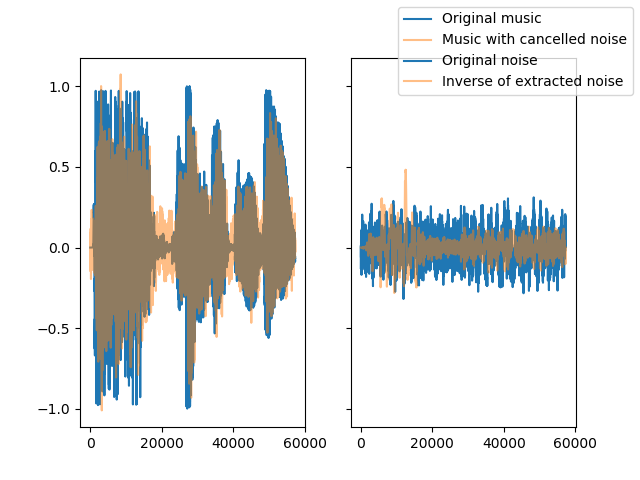

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


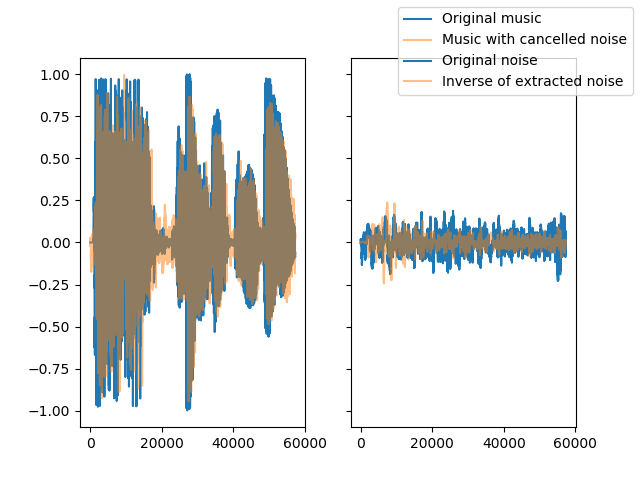

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


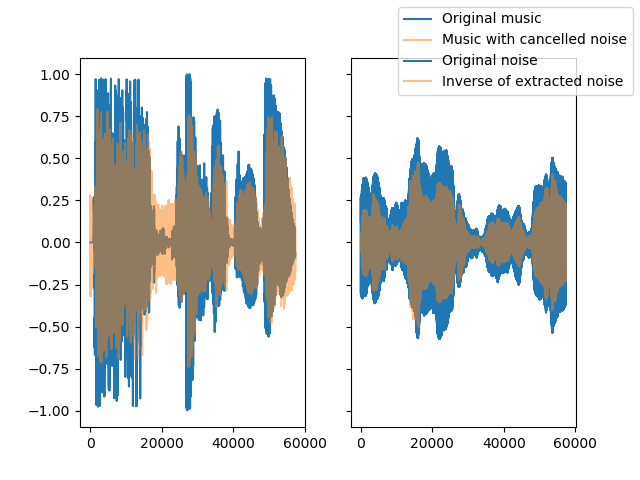

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


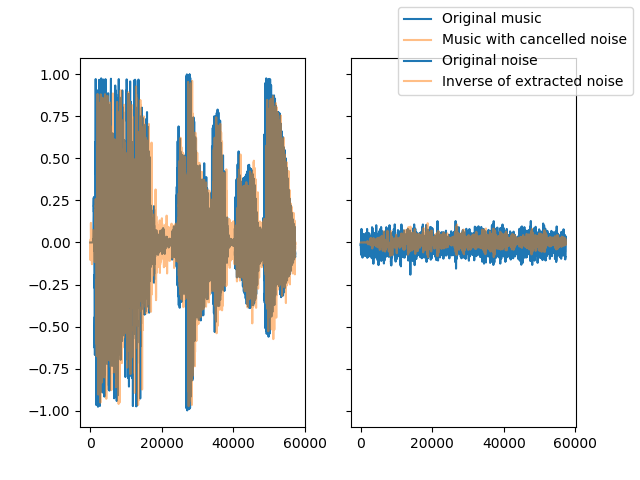

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


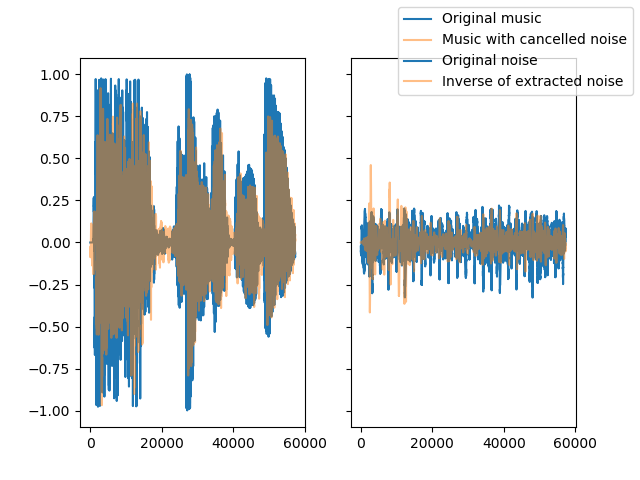

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


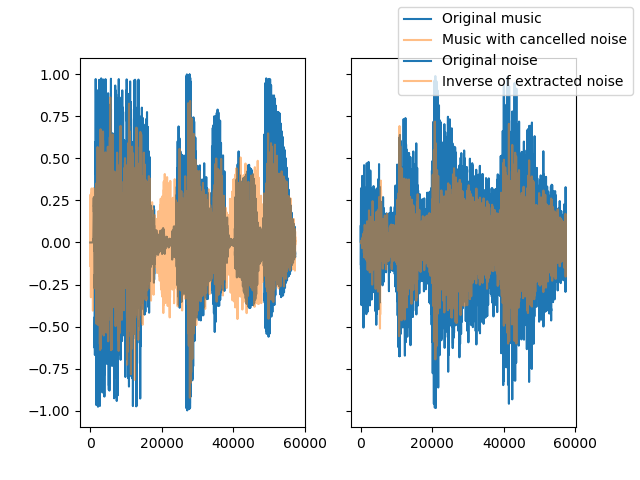

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


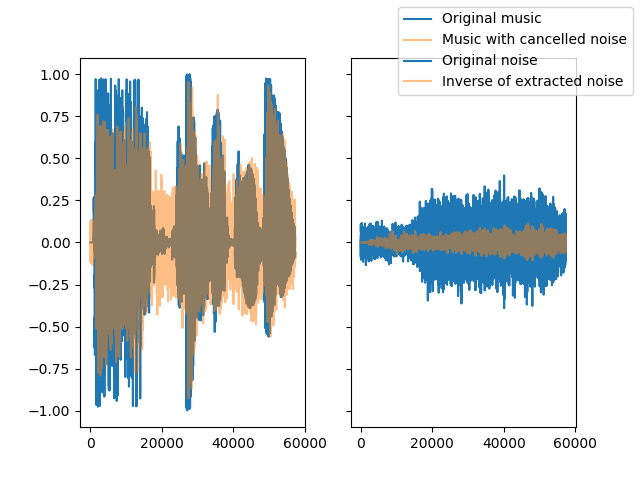

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


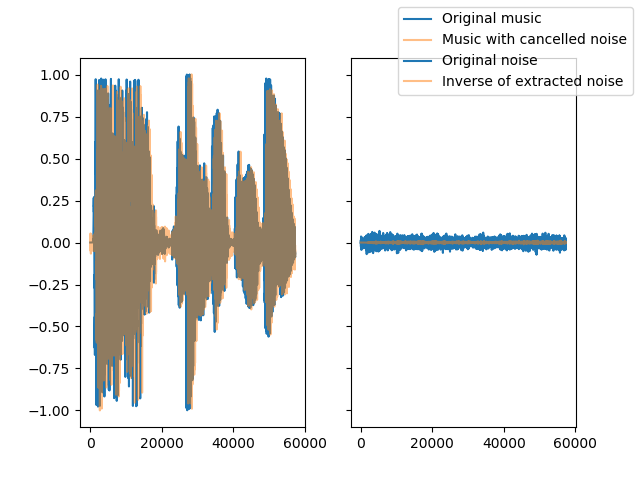

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


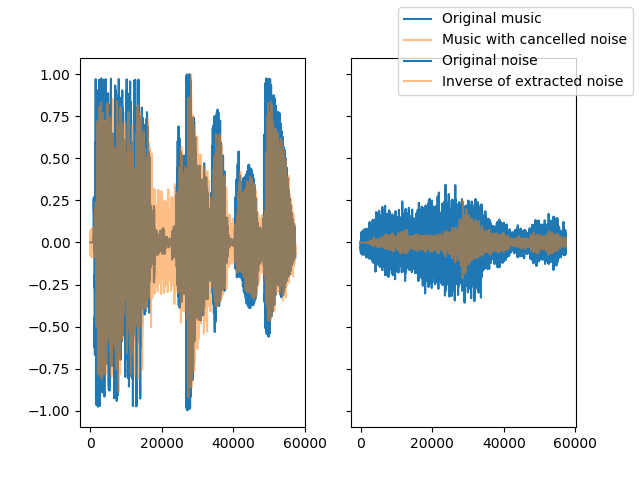

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


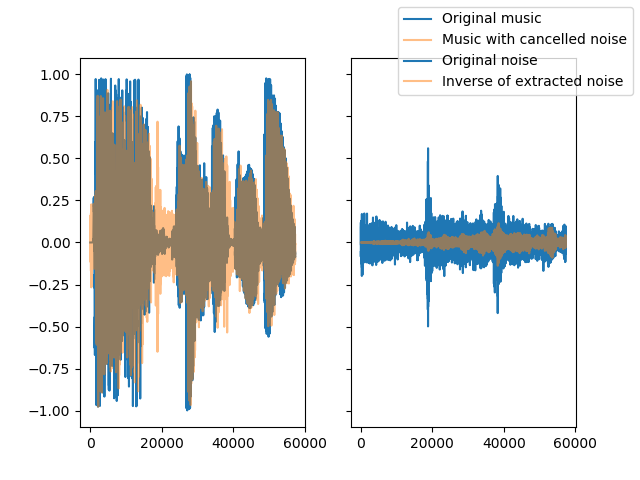

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


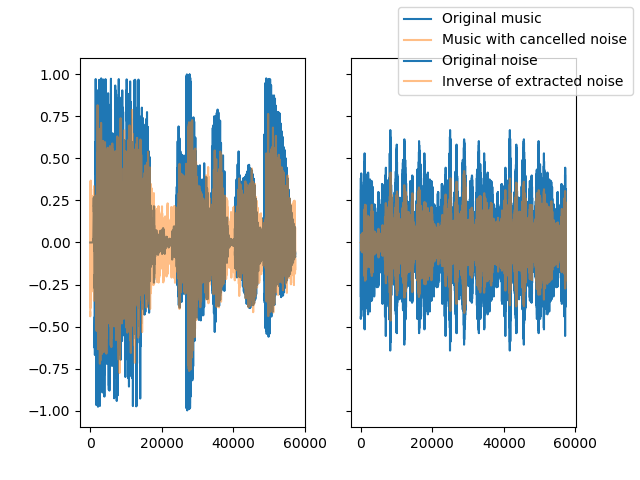

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


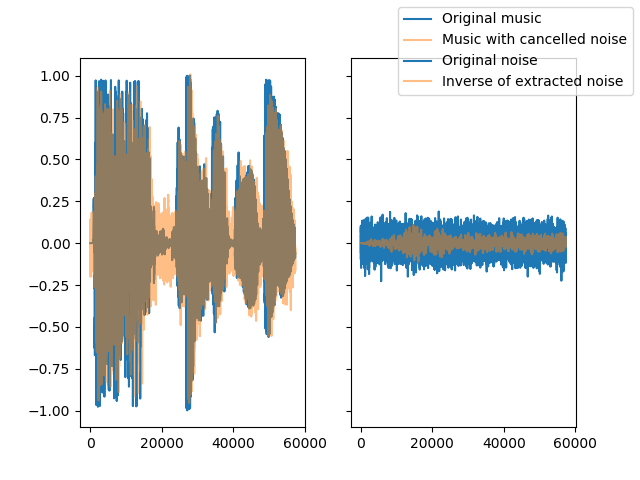

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


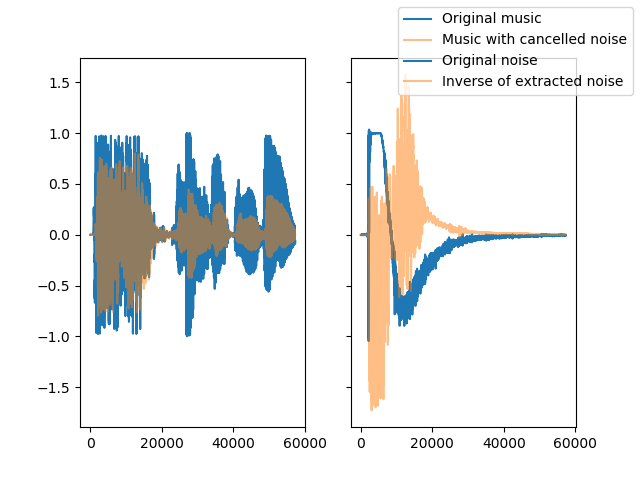

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


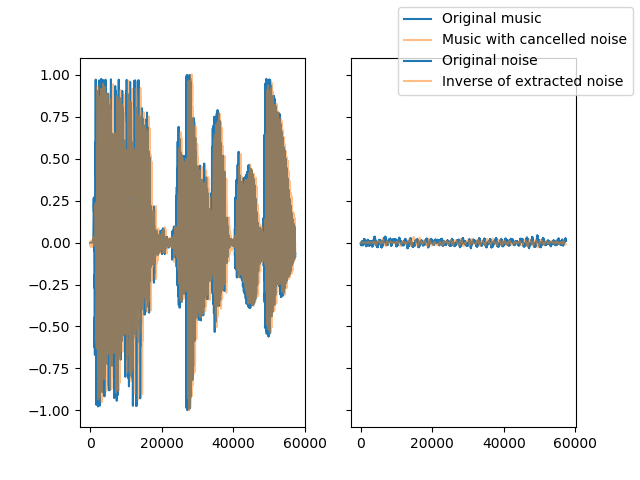

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


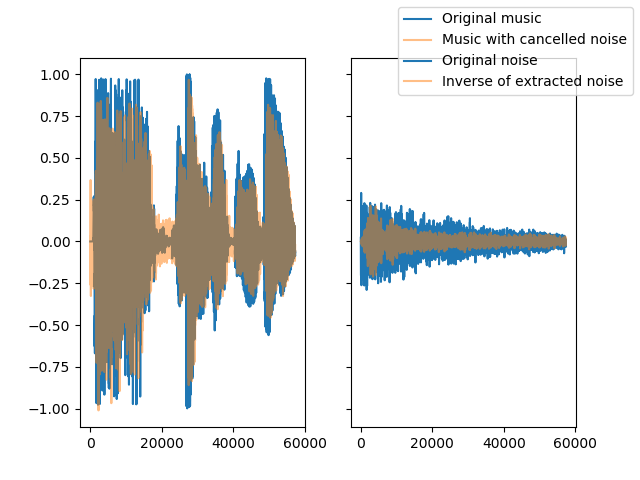

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


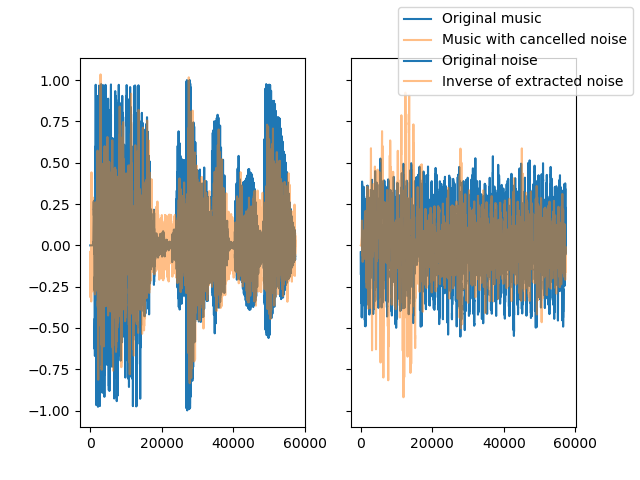

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


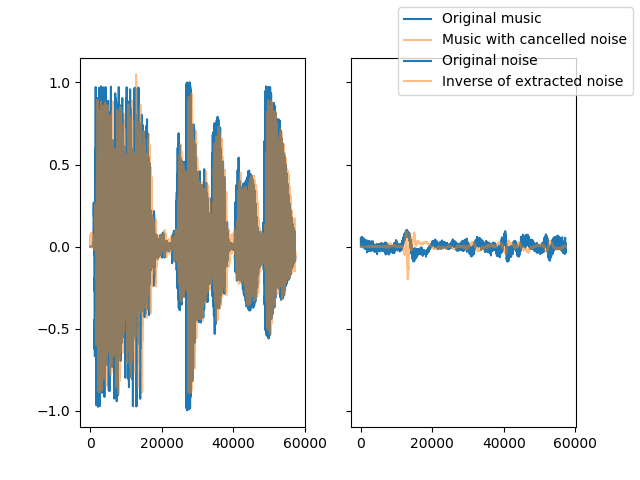

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


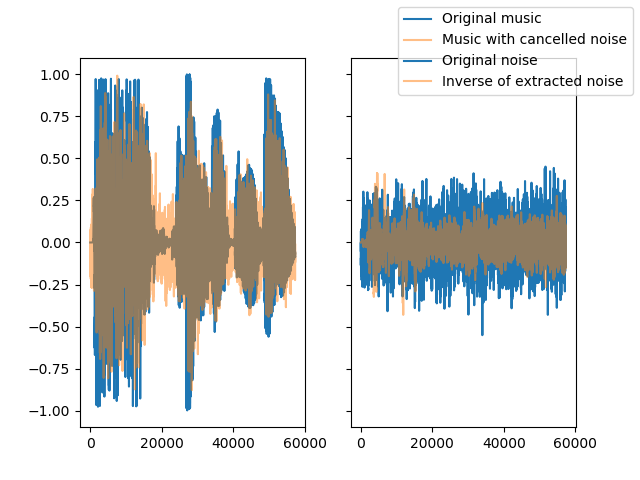

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


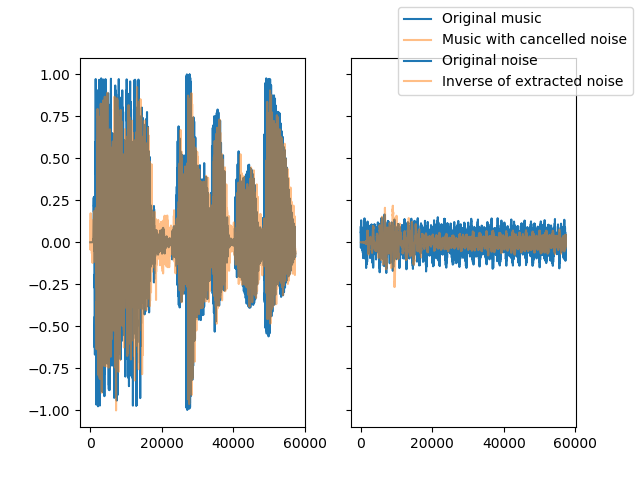

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


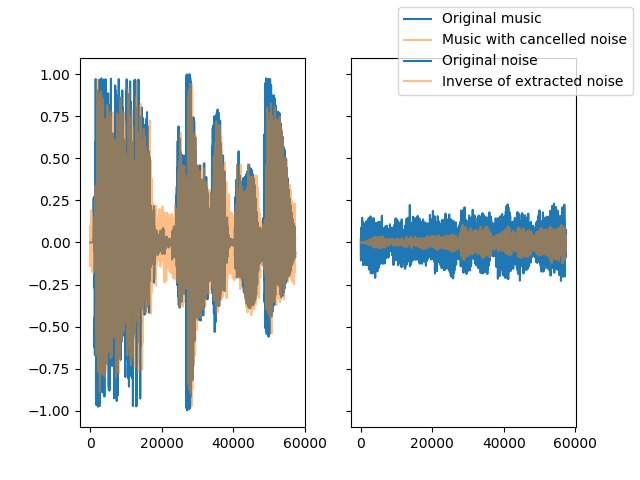

Original Music


Original Noise


Noisy Music


Music with ANC


Average MSE loss for all samples is 0.11809271138181254
Standard Deviation of MSE loss for all sample is 0.013256003269636494


In [14]:
noisy_music_folder = "Sounds/ProcessedTest/fold0/"
ancFolder = "LMS/LMSOutput/filterOutput"
display=True
offset = 2

mses = []
for i in range(20):

    noisy_music_file = base_folder + noisy_music_folder + str(i * 20 + offset) + ".RAW"
    noisy_music = sf.SoundFile(noisy_music_file, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    noisy_music = librosa.util.normalize(noisy_music)

    noise_file = base_folder + ancFolder + str(i) + ".RAW"
    noise = sf.SoundFile(noise_file, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    noise_offset = np.subtract(noise, np.mean(noise))
    noise_scale = np.multiply(noise, 1.25)
    noise_inv = np.negative(noise_scale)

    anc_music = np.add(noisy_music, noise_inv)

    og_music, _ = librosa.load(originalFiles[i * 20 + offset][1].strip(), mono=True, sr=44100, duration=1.30)
    og_noise, _ = librosa.load(originalFiles[i * 20 + offset][0].strip(), mono=True, sr=44100, duration=1.30)

    if display:
        fig, axes = plt.subplots(1, 2, sharey='all')

        axes[0].plot(og_music, label="Original music", alpha=1)
        axes[0].plot(anc_music, label="Music with cancelled noise", alpha = 0.5)

        axes[1].plot(og_noise, label="Original noise", alpha = 1)
        axes[1].plot(noise_inv, label="Inverse of extracted noise", alpha=0.5)

        fig.legend()
        fig.show()

        og_music_clip    = np.clip(og_music,    -1.0, 1.0)
        og_noise_clip    = np.clip(og_noise,    -1.0, 1.0)
        anc_music_clip   = np.clip(anc_music,   -1.0, 1.0)
        noisyMusicClip = np.clip(noisy_music, -1.0, 1.0)

        print("Original Music")
        ipd.display((ipd.Audio(og_music_clip,    rate=44100, normalize=False)))

        print("Original Noise")
        ipd.display((ipd.Audio(og_noise_clip,    rate=44100, normalize=False)))

        print("Noisy Music")
        ipd.display((ipd.Audio(noisyMusicClip, rate=44100, normalize=False)))

        print("Music with ANC")
        ipd.display((ipd.Audio(anc_music_clip,   rate=44100, normalize=False)))

    mse = (np.square(anc_music - og_music)).mean(axis=0)
    mses.append(mse)
    
print("Average MSE loss for all samples is {}".format(np.mean(mses)))
print("Standard Deviation of MSE loss for all sample is {}".format(np.std(mses)))

## Calculate noise cancellation on real noisy music with a generator trained in a supervised manner - loss calculated using the MSE between the original noise and the cancelled noise

### Generate 20 samples

In [15]:
generator = Pytorch_Generator.Net()

device = torch.device("cuda")
generator.to(device)

generator.load_state_dict(torch.load("generatorModelNew9.pt"))
generator.eval()

generator.generate(AudioDataset.NoisyMusicDataset(musicFolder="ProcessedTest", folderIndex=0), "GeneratorNewOutput")

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/189982-0-0-19.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/2.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/57320-0-0-11.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/22.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/157867-8-0-8.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/42.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold7/202516-0-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/62.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/146186-5-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/82.RAW

/home/sebltm/OneDri

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/155280-2-0-13.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/842.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold6/175917-3-1-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/862.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold9/168906-9-0-114.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/882.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold8/180132-4-3-0.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/902.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold2/178521-2-0-18.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/922.RAW

/home/sebl

/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


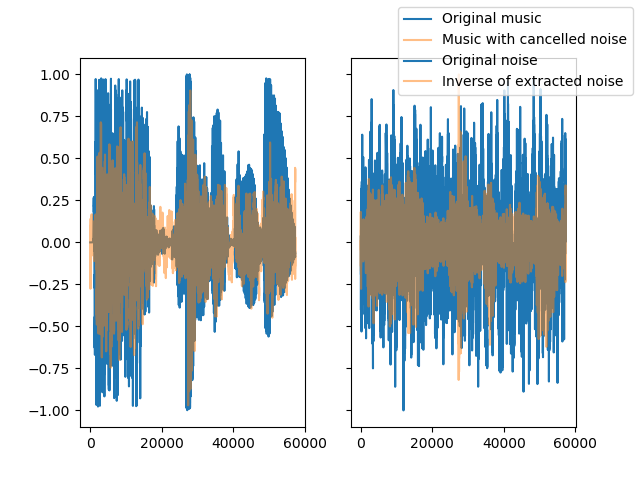

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


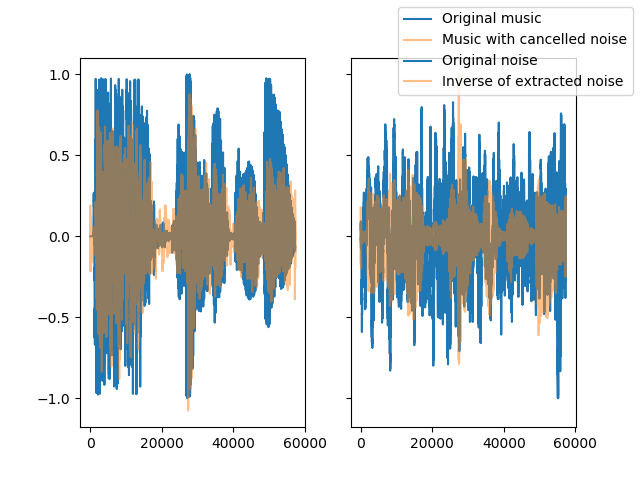

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


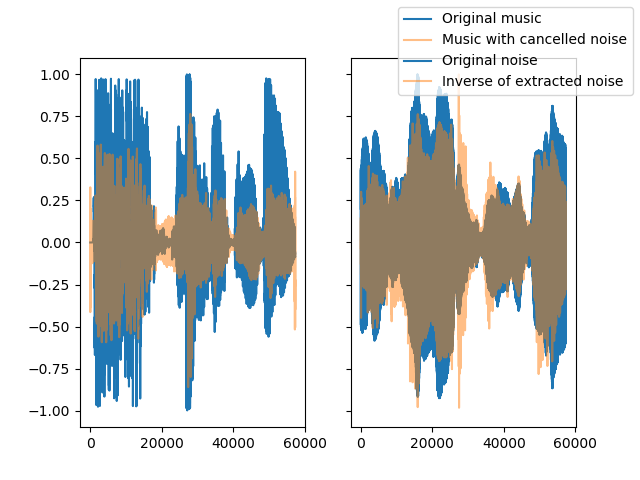

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


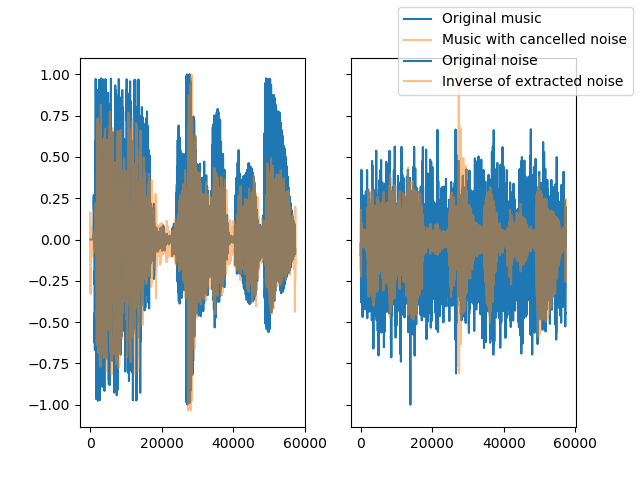

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


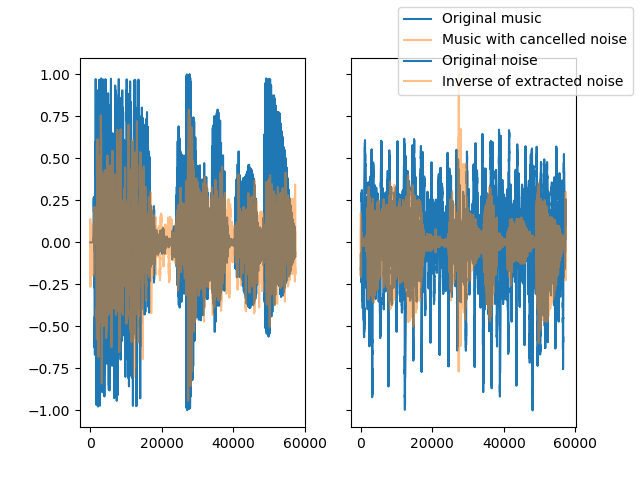

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


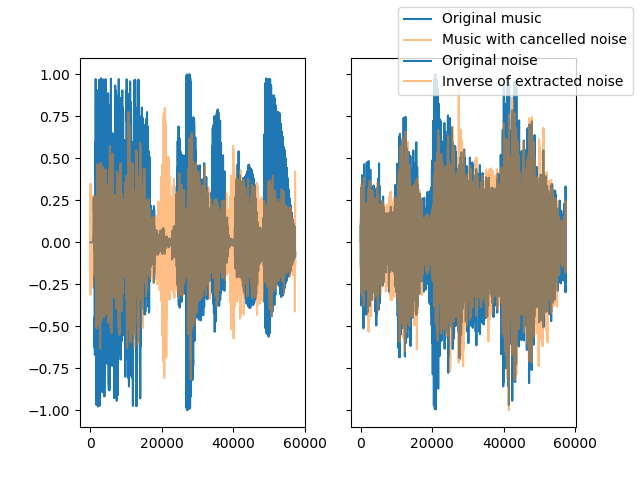

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


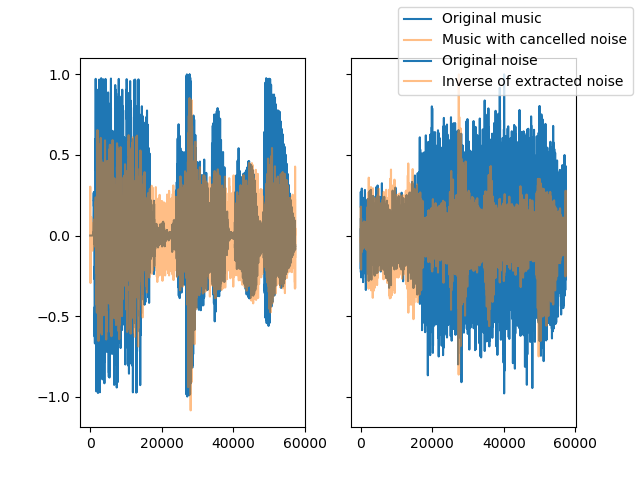

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


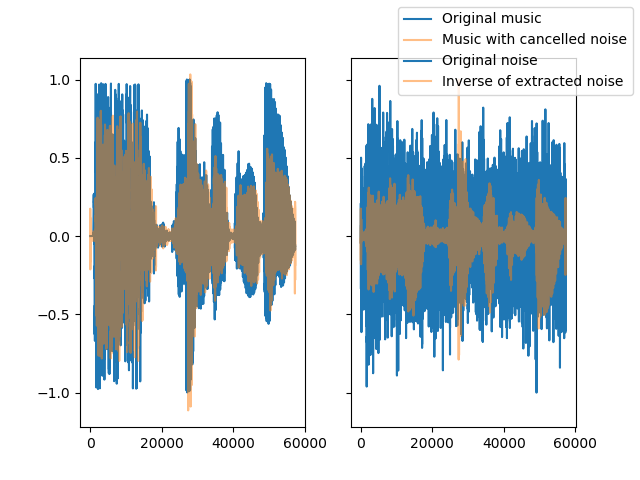

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


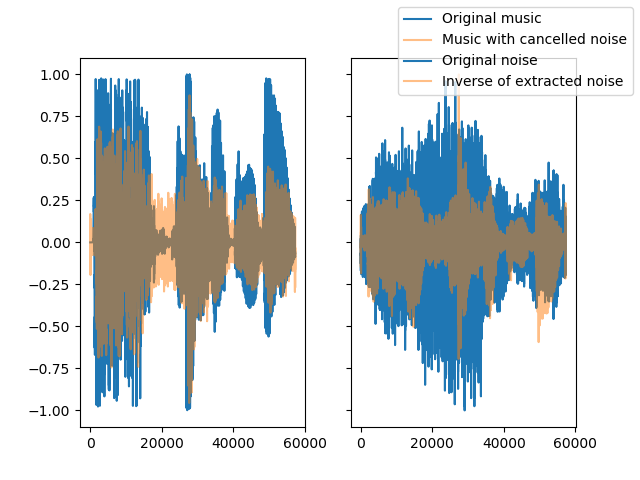

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


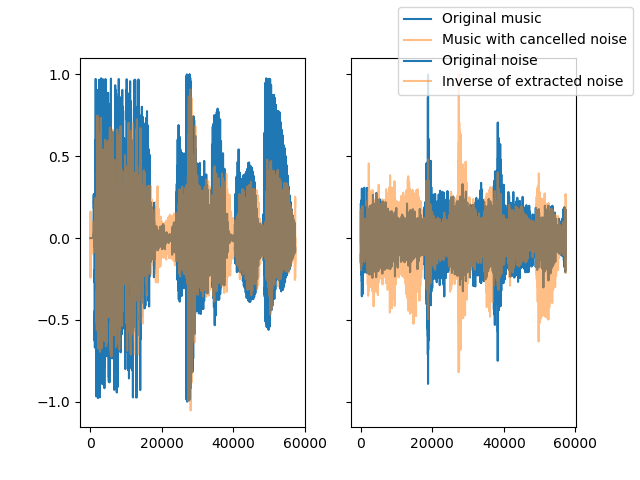

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


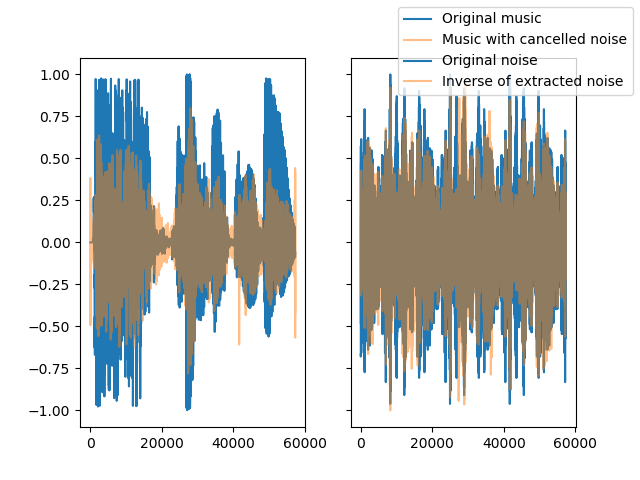

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


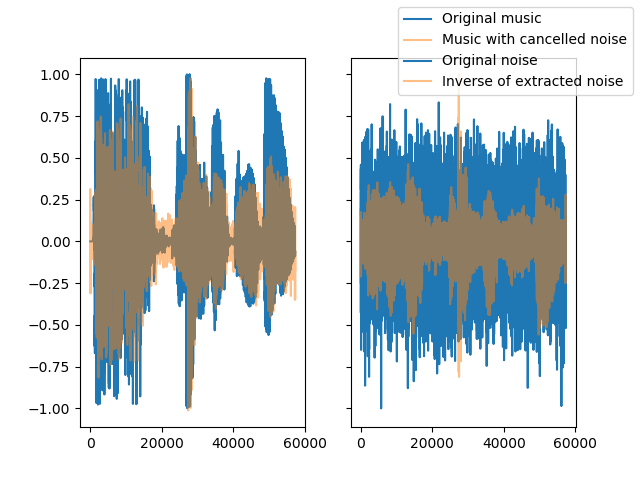

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


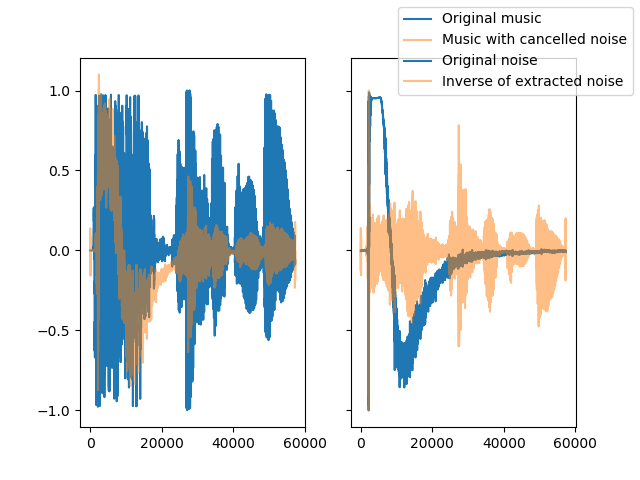

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


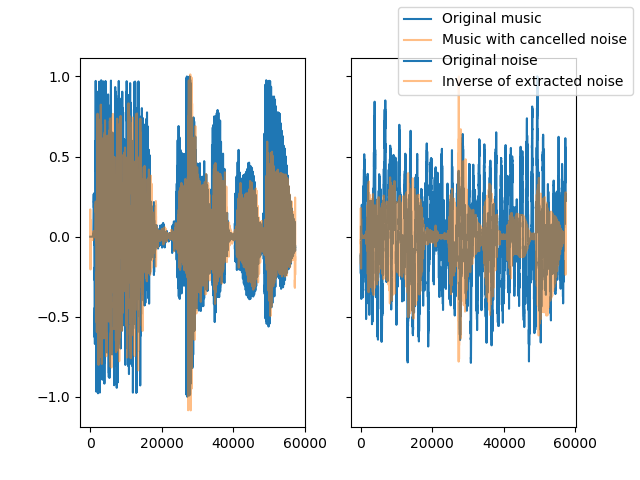

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


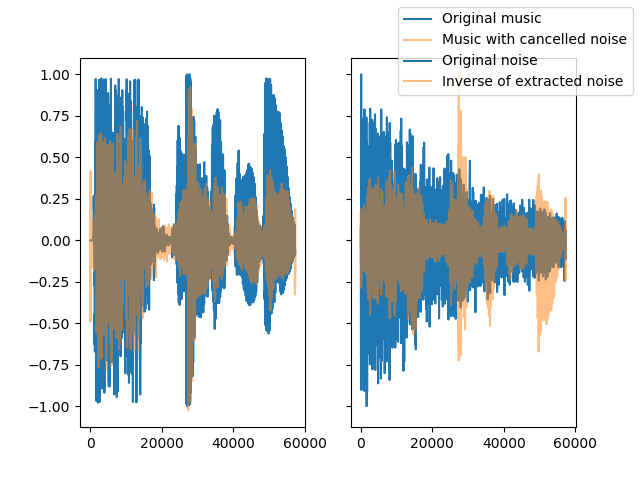

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


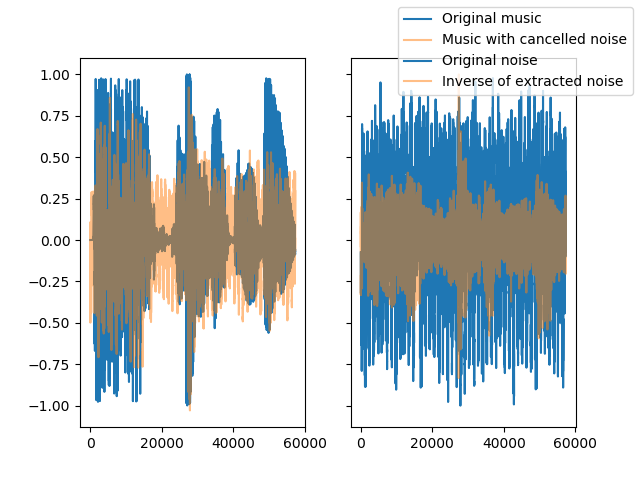

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


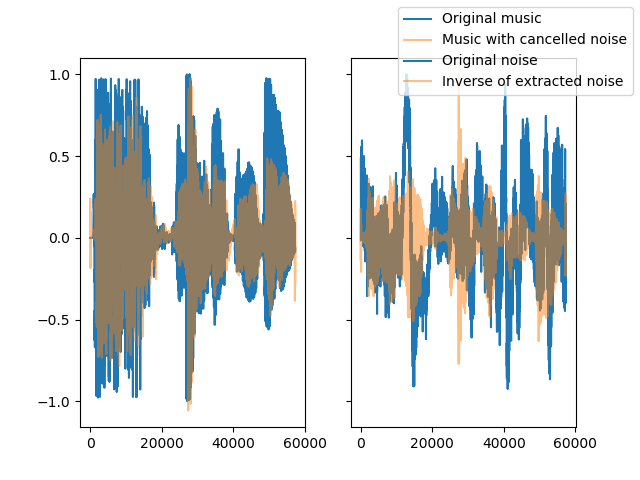

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


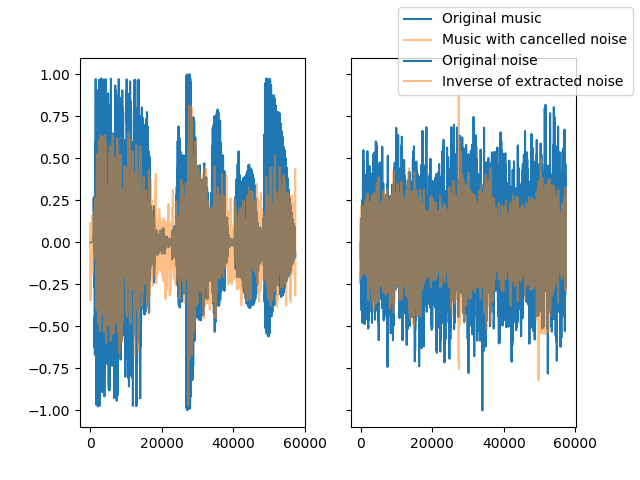

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


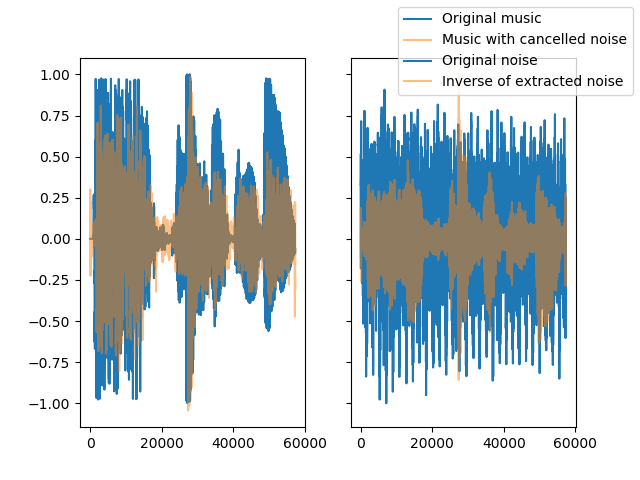

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


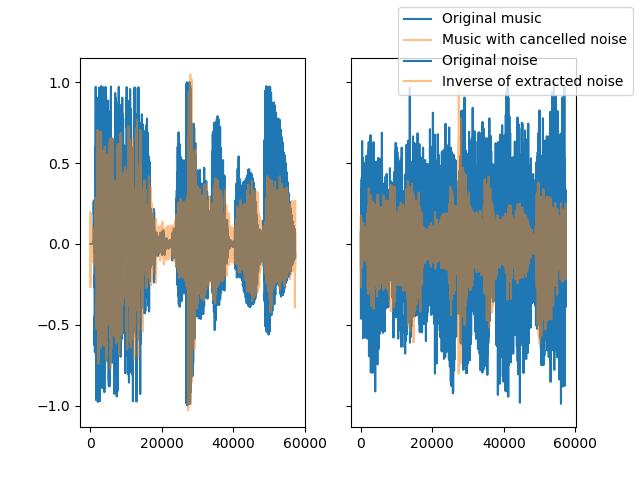

Original Music


Original Noise


Noisy Music


Music with ANC


Average MSE loss for all samples is 0.11358797055211242
Standard Deviation of MSE loss for all sample is 0.009701609028063472


In [16]:
mean, std = calculate_anc(base_folder, "Sounds/ProcessedTest/fold0/", "GAN-ANC/GeneratorNewOutput/", display=True)
print("Average MSE loss for all samples is {}".format(mean))
print("Standard Deviation of MSE loss for all sample is {}".format(std))

### Calculate noise cancellation on real noisy music with a generator trained using a Generative Adversarial Network

### Generate 20 samples

In [7]:
generator = Pytorch_Generator.Net()

device = torch.device("cuda")
generator.to(device)

generator.load_state_dict(torch.load("generatorGANModel14.pt"))
generator.eval()

generator.generate(AudioDataset.NoisyMusicDataset(musicFolder="ProcessedTest", folderIndex=0), "GANOutput")

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/189982-0-0-19.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/2.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/57320-0-0-11.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/22.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/157867-8-0-8.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/42.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold7/202516-0-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/62.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/146186-5-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/82.RAW

/home/sebltm/OneDri

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/155280-2-0-13.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/842.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold6/175917-3-1-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/862.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold9/168906-9-0-114.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/882.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold8/180132-4-3-0.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/902.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold2/178521-2-0-18.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/922.RAW

/home/sebl

/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


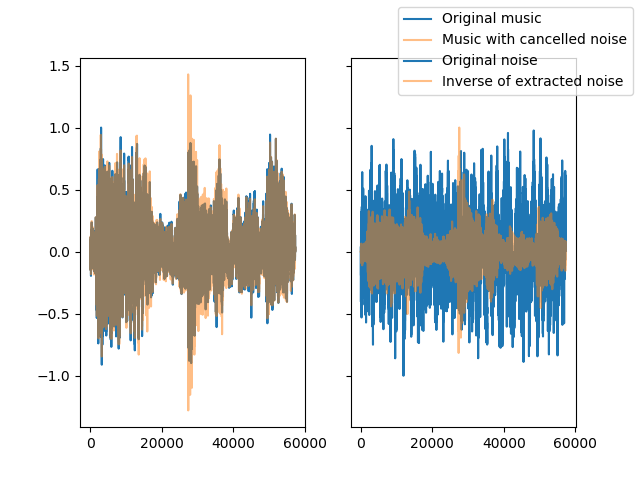

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


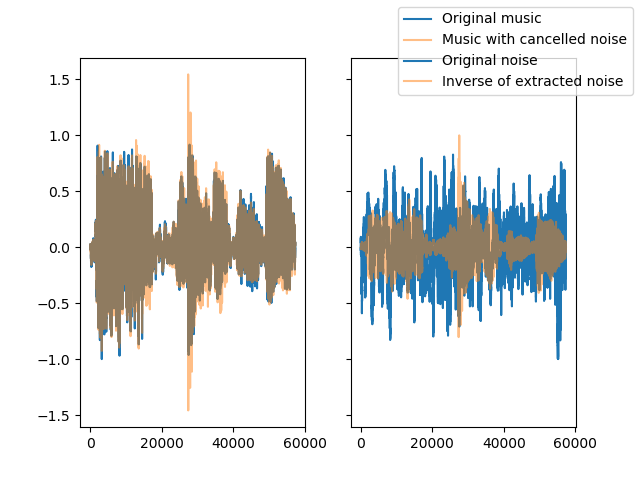

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


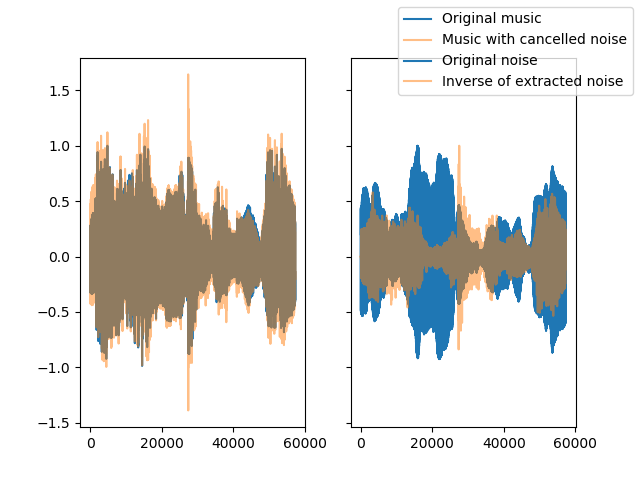

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


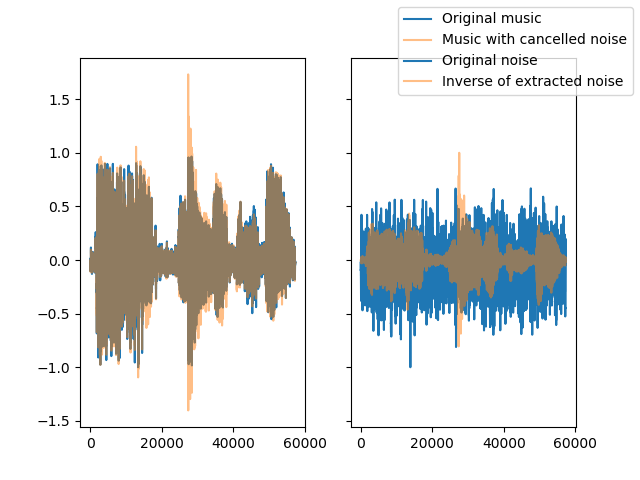

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


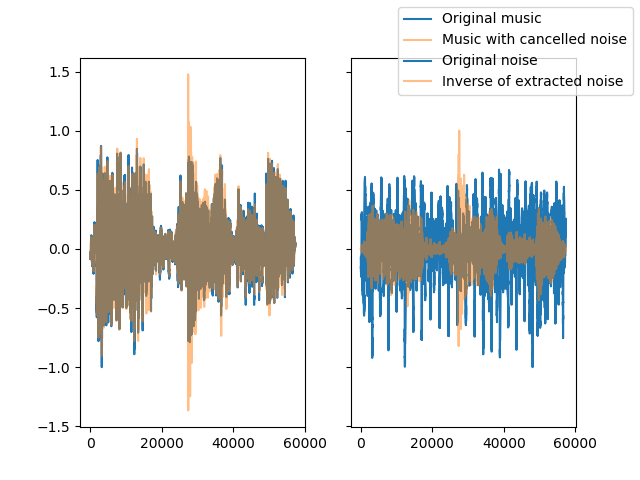

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


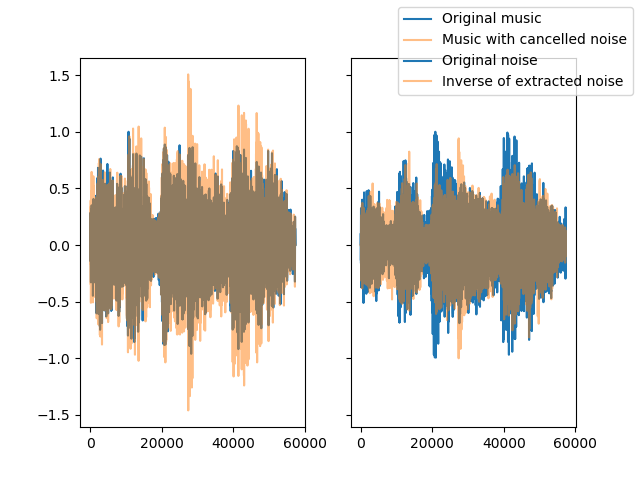

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


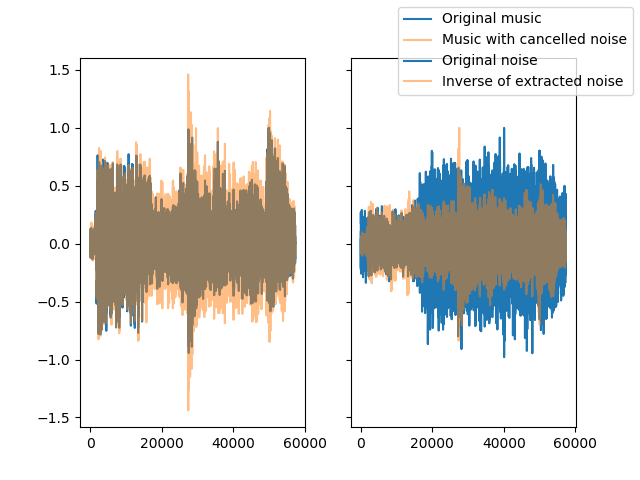

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


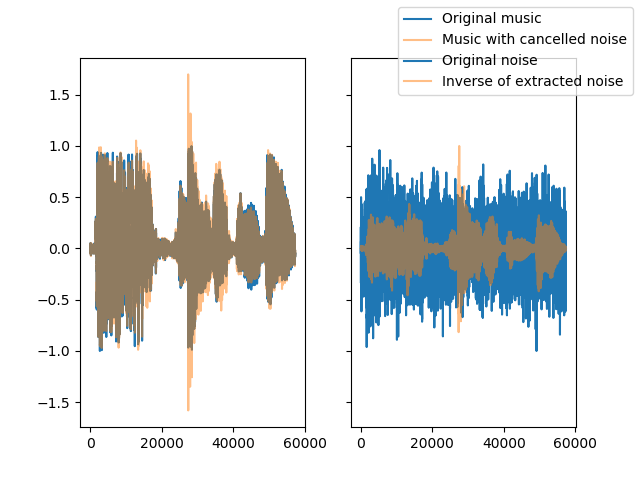

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


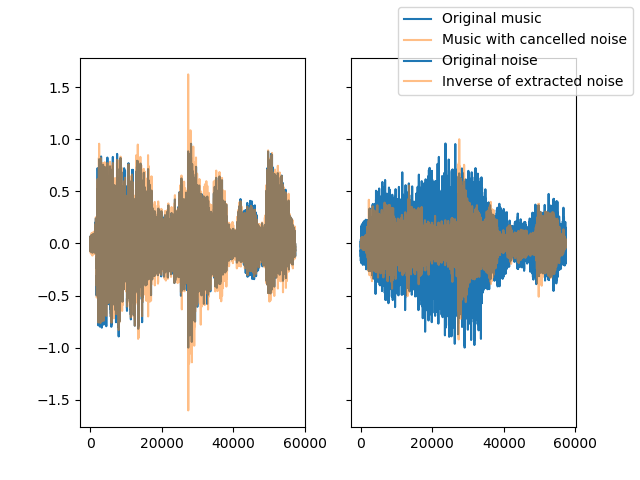

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


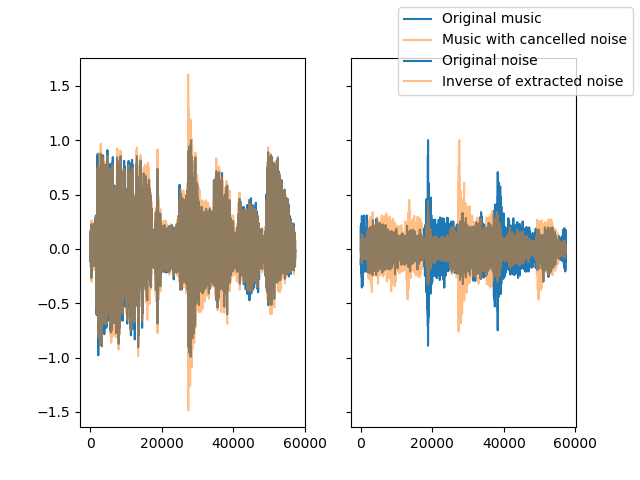

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


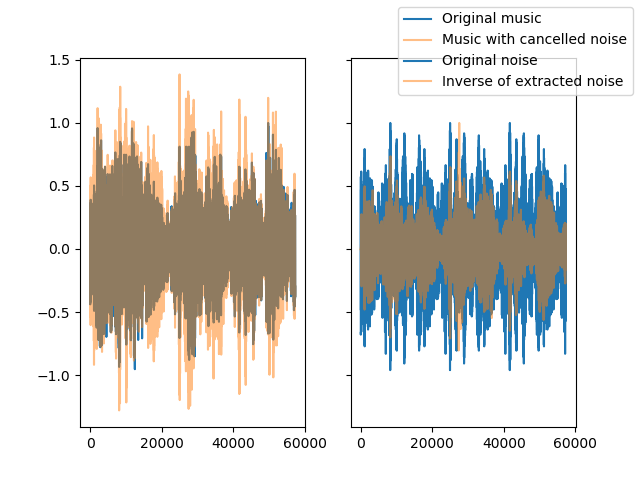

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


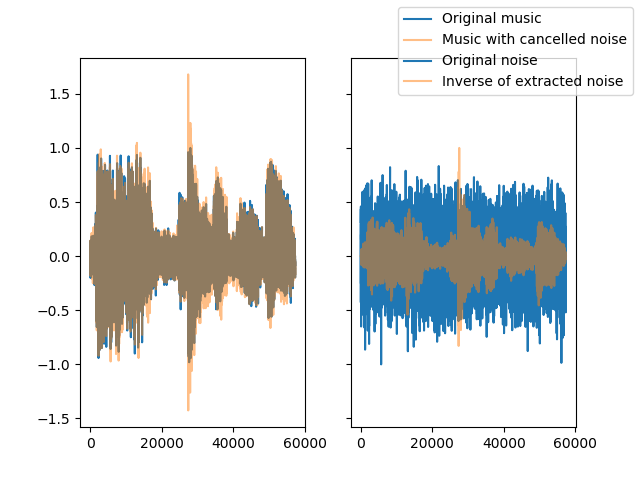

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


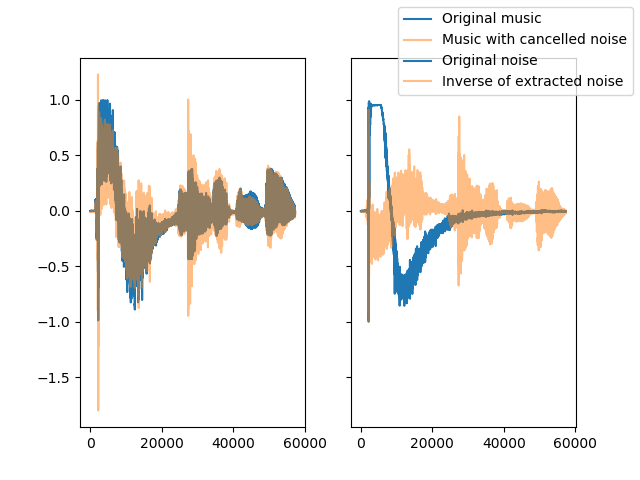

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


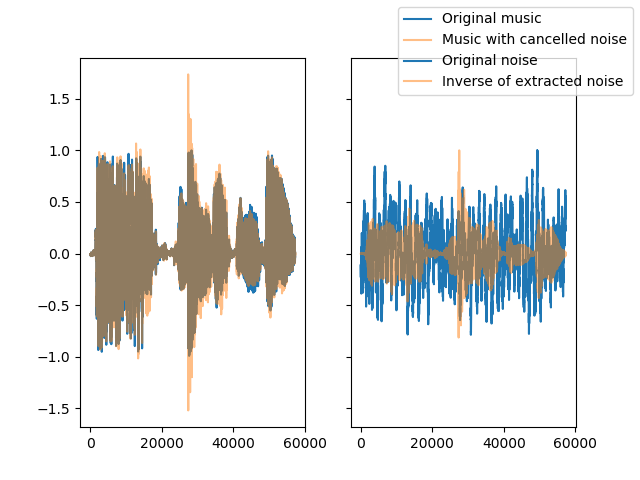

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


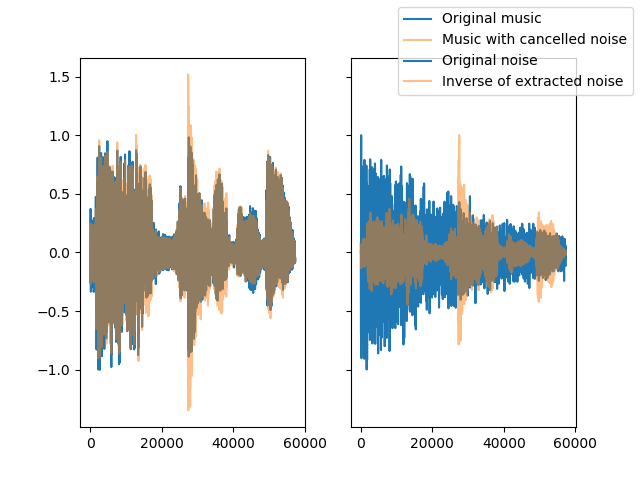

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


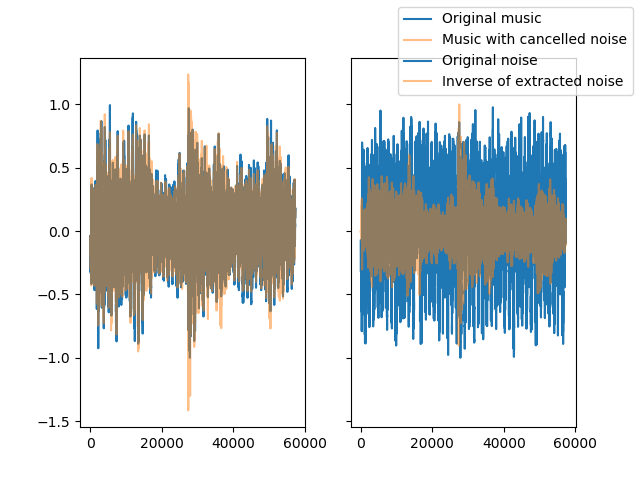

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


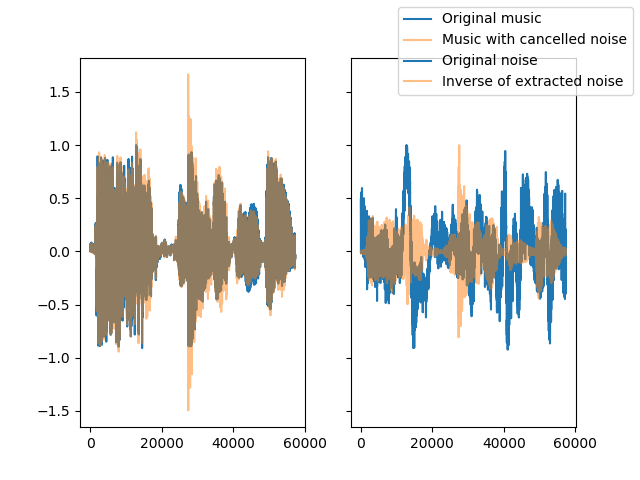

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


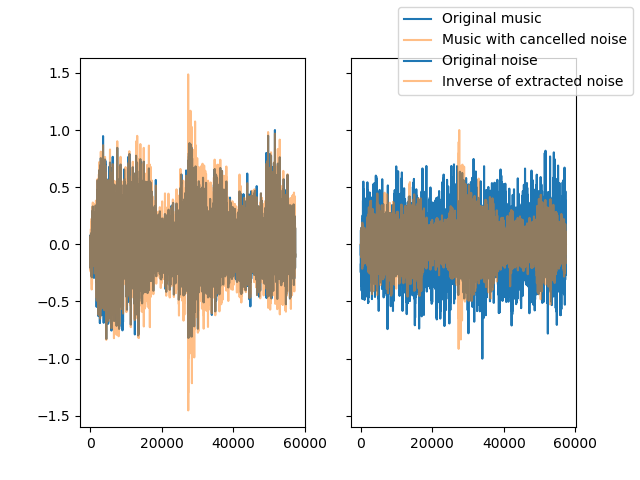

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


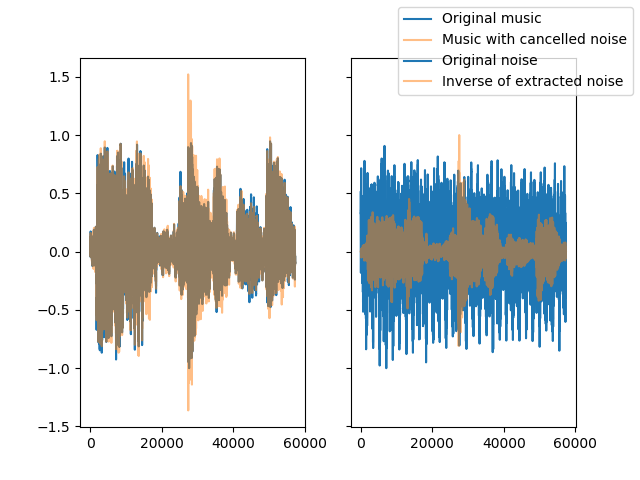

Original Music


Original Noise


Noisy Music


Music with ANC


/home/sebltm/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


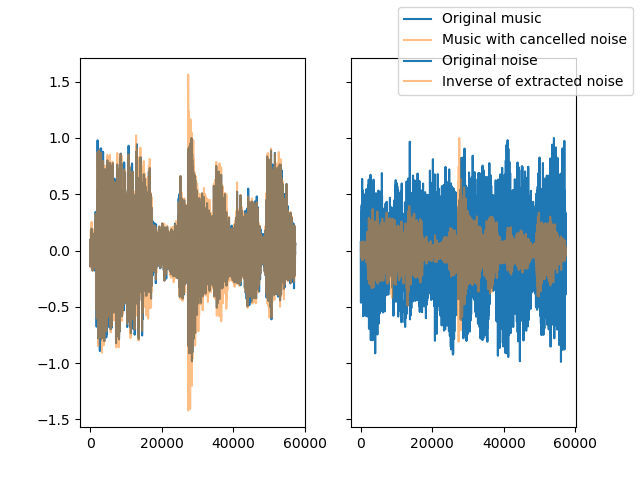

Original Music


Original Noise


Noisy Music


Music with ANC


Average MSE loss for all samples is 0.12676218845063222
Standard Deviation of MSE loss for all sample is 0.01427110312296802


In [8]:
mean, std = calculate_anc(base_folder, "Sounds/ProcessedTest/fold0/", "GAN-ANC/GANOutput/", display=True)
print("Average MSE loss for all samples is {}".format(mean))
print("Standard Deviation of MSE loss for all sample is {}".format(std))

In [10]:
soundMetadata = pd.read_csv("/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/metadata/UrbanSound8K.csv")
print(soundMetadata)

         slice_file_name    fsID       start         end  salience  fold  \
0       100032-3-0-0.wav  100032    0.000000    0.317551         1     5   
1     100263-2-0-117.wav  100263   58.500000   62.500000         1     5   
2     100263-2-0-121.wav  100263   60.500000   64.500000         1     5   
3     100263-2-0-126.wav  100263   63.000000   67.000000         1     5   
4     100263-2-0-137.wav  100263   68.500000   72.500000         1     5   
...                  ...     ...         ...         ...       ...   ...   
8727     99812-1-2-0.wav   99812  159.522205  163.522205         2     7   
8728     99812-1-3-0.wav   99812  181.142431  183.284976         2     7   
8729     99812-1-4-0.wav   99812  242.691902  246.197885         2     7   
8730     99812-1-5-0.wav   99812  253.209850  255.741948         2     7   
8731     99812-1-6-0.wav   99812  332.289233  334.821332         2     7   

      classID             class  
0           3          dog_bark  
1           2  chil